### Improving Semantic Water Segmentation by Fusing Sentinel-1 Intensity and Interferometric Synthetic Aperture Radar (InSAR) Coherence Data

**Author: Ernesto Colon**

**The Cooper Union for the Advancement of Science and Art**

#### Visuals

In [1]:
# Import libraries
import os
import matplotlib.pyplot as plt
import rasterio
import numpy as np

Define helper functions to create composites and clip images for visualization purposes

In [2]:
def s2_rgb_composite(pth):
    """
    Function to return RGB composite given Sentinel-2 multi-band geotiff
    :param pth: path to Sentinel-2 raster
    :return: ndarray with Sentinel-2 RGB composite
    """
    # open the raster
    with rasterio.open(pth) as src:
        # For Sentinel-2
        # R: 3
        # G: 2
        # B: 1

        # create the rgb composite
        rgb = np.dstack([src.read(4),
                         src.read(3),
                         src.read(2)])

    # scale RGB composite
    rgb = rgb / 5000.

    # clip between 0 and 1
    rgb = rgb.clip(0.0, 1.0)

    return rgb


def s1_raster_load(pth):
    """
    Function to load Sentinel-1 geotiff from disk
    :param pth: path to Sentinel-1 geotfiff
    :return: ndarray with Sentinel-1 raster
    """

    with rasterio.open(pth) as src:
        s1_img = np.transpose(np.squeeze(src.read()), axes=(1, 2, 0))

    return s1_img


def load_label(pth):
    """
    Function to load ground truth label from Sen1Floods11 data set
    :param pth: path to label geotiff
    :return: ndarray with ground truth label
    """

    with rasterio.open(pth) as src:
        label = np.squeeze(src.read())
        label = np.where(label == -1, 0, label)

    return label

Load overlapping Sentinel-1 and Sentinel-2 scenes for plotting

Each file follows the following format: REGION_ID_SxHand.tif... I can use this to construct my paths

The labels follow the following naming convention: REGION_ID_LabelHand.tif

In [3]:
# define paths to geotiff files
s2_hand_root_dir = r"D:\SAR_data\Sen1Floods11\v1.1\data\flood_events\HandLabeled\S2Hand"
s1_hand_root_dir = r"D:\SAR_data\Sen1Floods11\v1.1\data\flood_events\HandLabeled\S1Hand"
label_hand_root_dir = r"D:\SAR_data\Sen1Floods11\v1.1\data\flood_events\HandLabeled\LabelHand"

# define regions of interest
regions = ['USA', 'Mekong', 'Colombia', 'Bolivia', 'Paraguay', 'India', 'Sri-Lanka']

# dictionary to store filepaths
chip_ids = {region : [] for region in regions}

# Grab all the chip ID's
for region in regions:
    for f in os.listdir(s1_hand_root_dir):
        if region in f:
            chip_ids[region].append(f.split("\\")[-1].split("_S")[0])

Loop through chip ID's and construct file paths

In [4]:
# create dictionary to store filepaths
hand_lbl_s1_s2_pths = {region : [] for region in regions}

for region in regions:
    # grab the current chip's list
    region_chips = chip_ids[region]

    for chip in region_chips:
        # append Sentinel-2 and Sentinel-1 path
        s2_pth = f"{s2_hand_root_dir}\\{chip}_S2Hand.tif"
        s1_pth = f"{s1_hand_root_dir}\\{chip}_S1Hand.tif"
        lbl_pth = f"{label_hand_root_dir}\\{chip}_LabelHand.tif"

        hand_lbl_s1_s2_pths[region].append([s2_pth, s1_pth, lbl_pth])

Load a few chips to memory for plotting

In [5]:
# grab to regions of interest that have valid hand labels
regions_to_pluck = [region for region in regions if region != 'Colombia']

# create dictionary with lists to store the file paths
hand_s1_s2_chips = {region : [] for region in regions_to_pluck}

num_chips_pluck = 10

for region in regions_to_pluck:
    for idx in range(num_chips_pluck):
        hand_s1_s2_chips[region].append([s2_rgb_composite(hand_lbl_s1_s2_pths[region][idx][0]),
                                         s1_raster_load(hand_lbl_s1_s2_pths[region][idx][1]),
                                         load_label(hand_lbl_s1_s2_pths[region][idx][2])])

Plot the chips

In [6]:
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import matplotlib.font_manager as fm
fontprops = fm.FontProperties(size=8)

def s1_clip_int(ax, img, pct_low=1, pct_high=99):
    """
    Function to clip and plot Sentinel-1 raster intensity given lower and upper percentiles
    :param ax: axis object to plot / display raster
    :param img: ndarray with Sentinel-1 image data
    :param pct_low: integer with lower percentile value to clip image
    :param pct_high: integer with upper percentile value to clip image
    :return: None, function plots the Sentinel-1 raster
    """

    # plot the raster
    ax.imshow(img,
              extent=[0,512,0,512],
              vmin=np.nanpercentile(img, pct_low),
              vmax=np.nanpercentile(img, pct_high),
              cmap='gray')

    # generate scale legend
    scalebar = AnchoredSizeBar(ax.transData,
                           100, '100m', 'lower left',
                           pad=0.1,
                           color='black',
                           frameon=False,
                           size_vertical=1,
                           fontproperties=fontprops)

    ax.add_artist(scalebar)
    ax.set_yticks([])
    ax.set_xticks([])


def rgb_resc_int(ax, img, pct_low=1, pct_high=99):
    """
    Function to rescale RGB composites
    :param ax: axis object to plot / display raster
    :param img: ndarray with RGB image data
    :param pct_low: integer with lower percentile value to clip image
    :param pct_high: integer with upper percentile value to clip image
    :return: None, function plots the Sentinel-1 raster
    """

    # plot the raster
    ax.imshow(img,
              extent=[0,512,0,512],
              vmin=np.nanpercentile(img, pct_low),
              vmax=np.nanpercentile(img, pct_high))

    # generate the scale legend
    scalebar = AnchoredSizeBar(ax.transData,
                           100, '100m', 'lower left',
                           pad=0.1,
                           color='black',
                           frameon=False,
                           size_vertical=1,
                           fontproperties=fontprops)

    ax.add_artist(scalebar)
    ax.set_yticks([])
    ax.set_xticks([])


def display_label(ax, img, cmap):
    """
    Function to display the ground truth labels
    :param ax: axis object to display raster
    :param img: ndarray with ground truth label
    :param cmap: colormap for labels
    :return: None, function plots the ground truth labels
    """

    # plot the ground truth labels
    ax.imshow(img, extent=[0,512,0,512], cmap=cmap)

    # generate the scale legend
    scalebar = AnchoredSizeBar(ax.transData,
                           100, '100m', 'lower left',
                           pad=0.1,
                           color='black',
                           frameon=False,
                           size_vertical=1,
                           fontproperties=fontprops)

    ax.add_artist(scalebar)
    ax.set_yticks([])
    ax.set_xticks([])

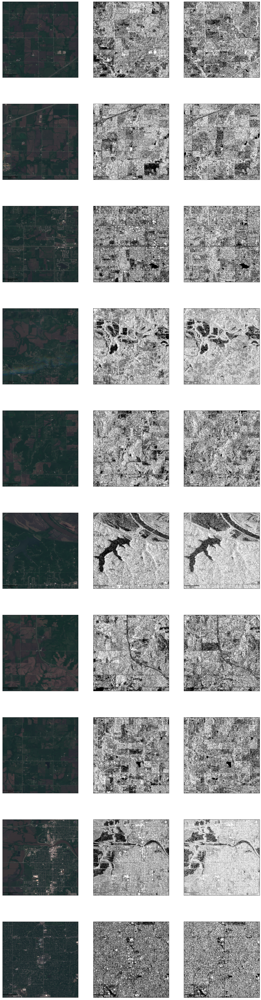

In [7]:
num_rows = num_chips_pluck
num_col = 3

fig, ax = plt.subplots(num_rows, num_col, figsize=(20, 80))
ax = ax.ravel()

for idx in range(num_rows):

    # plot the Sentinel-2 chip
    rgb_resc_int(ax[num_col * idx], hand_s1_s2_chips['USA'][idx][0], pct_low=2, pct_high=95)
    #ax[num_col * idx].imshow(hand_s1_s2_chips['USA'][idx][0])

    # plot the Sentinel-1 VV band
    s1_clip_int(ax[num_col * idx + 1], hand_s1_s2_chips['USA'][idx][1][:, :, 0])

    # display the Sentinel-1 VH band
    s1_clip_int(ax[num_col * idx + 2], hand_s1_s2_chips['USA'][idx][1][:, :, 1])

Introduce a false color composite for the Sentinel-1 scenes to highlight water.

The false color composite will be similar to the one in the competition linked below:

https://www.drivendata.co/blog/detect-floodwater-benchmark/

In [8]:
# Helper functions for visualizing Sentinel-1 images
def scale_img(matrix):
    """
    Returns a scaled (H, W, D) image that is visually inspectable.
    Image is linearly scaled between min_ and max_value, by channel.

    Args:
        matrix (np.array): (H, W, D) image to be scaled

    Returns:
        np.array: Image (H, W, 3) ready for visualization
    """
    # Set min/max values
    min_values = np.array([-23, -28, 0.2])
    max_values = np.array([0, -5, 1])

    # Reshape matrix
    w, h, d = matrix.shape
    matrix = np.reshape(matrix, [w * h, d]).astype(np.float64)

    # Scale by min/max
    matrix = (matrix - min_values[None, :]) / (
        max_values[None, :] - min_values[None, :]
    )
    matrix = np.reshape(matrix, [w, h, d])

    # Limit values to 0/1 interval
    return matrix.clip(0, 1)


def sar_false_color_composite(vv_img, vh_img):
    """
    Returns a S1 false color composite for visualization.

    Args:
        vv_img: ndarray with Sentinel-1 VV-band raster
        vh_img: ndarray with Sentinel-1 VH-band raster

    Returns:
        np.array: image (H, W, 3) ready for visualization
    """

    # Stack arrays along the last dimension
    s1_img = np.stack((vv_img, vh_img), axis=-1)

    # Create false color composite
    img = np.zeros((512, 512, 3), dtype=np.float32)
    img[:, :, :2] = s1_img.copy()
    img[:, :, 2] = s1_img[:, :, 0] / s1_img[:, :, 1]

    return scale_img(img)

Recreate the dictionary with the sentinel-2, sentinel-1, and false color composite and load rasters to memory

In [9]:
regions_to_pluck = [region for region in regions if region != 'Colombia']
s1_s2_chips = {region : [] for region in regions_to_pluck}

num_chips_pluck = 10

for region in regions_to_pluck:
    for idx in range(num_chips_pluck):
        # Load Sentinel-1, Sentinel-2 and create false color composite
        s1_img = s1_raster_load(hand_lbl_s1_s2_pths[region][idx][1])
        false_color = sar_false_color_composite(s1_img[:, :, 0], s1_img[:, :, 1])
        label = load_label(hand_lbl_s1_s2_pths[region][idx][2])

        s1_s2_chips[region].append([s2_rgb_composite(
            hand_lbl_s1_s2_pths[region][idx][0]),
            s1_img[:, :, 0],
            false_color,
            label])

Plot: Sentinel-2, Sentinel-1 VV, and Sentinel-1 false color composite per region

In [10]:
import matplotlib.colors
from matplotlib.colors import ListedColormap

def ret_cmap(clr_lst):
    """
    Function to return colormap given a list with RGB colors
    :param clr_lst: list with hexadecimal RGB color values
    :return: Matplotlib colormap object
    """
    # convert hex to rgb
    colors = [matplotlib.colors.to_rgb(i) for i in clr_lst]

    # create cmap object
    return ListedColormap(colors)

lbl_cmap = ret_cmap(['#fff7fb', '#3690c0'])


def s2_s1_plots(raster_dict, region, num_chips):
    """
    Function to plot Sentinel-2, Sentinel-1, Sentinel-1 false color composite, and ground truth labels
    :param raster_dict: dictionary with ndarrays pertaining to Sentinel-2 and Sentinel-1 rasters
    :param region: string with geographical region being displayed
    :param num_chips: number of chips to display
    :return: None
    """
    num_rows = num_chips
    num_col = 4

    fig, ax = plt.subplots(num_rows, num_col, figsize=(20, 80))
    ax = ax.ravel()

    for idx in range(num_rows):

        # plot the Sentinel-2 chip
        rgb_resc_int(ax[num_col * idx], raster_dict[region][idx][0], pct_low=2, pct_high=95)

        # plot the Sentinel-1 VV band
        s1_clip_int(ax[num_col * idx + 1], raster_dict[region][idx][1])

        # display the Sentinel-1 VH band
        s1_clip_int(ax[num_col * idx + 2], raster_dict[region][idx][2])

        # display label
        display_label(ax[num_col * idx + 3], raster_dict[region][idx][3], cmap=lbl_cmap)

    #return fig

### USA

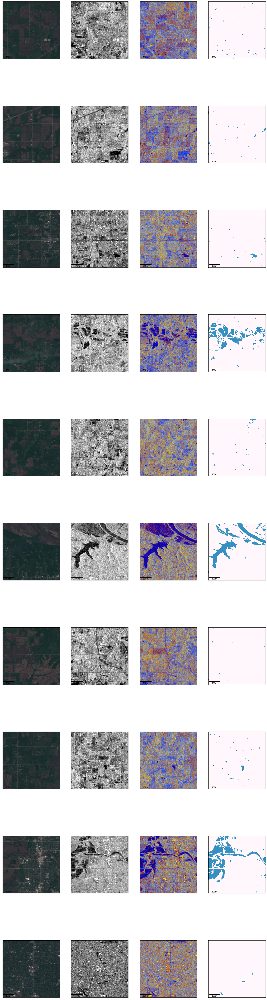

In [11]:
region = 'USA'
num_chips = 10
s2_s1_plots(s1_s2_chips, region, num_chips)

### Mekong

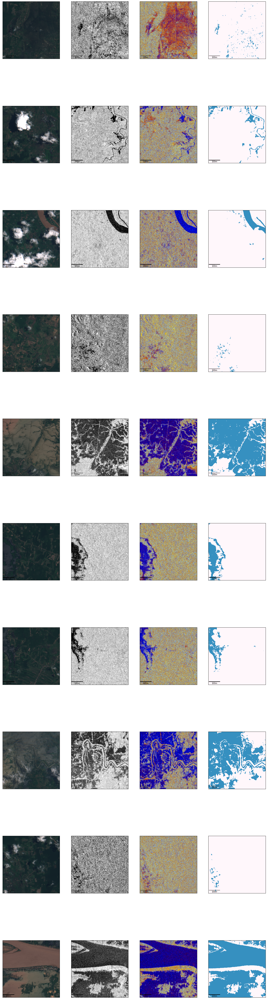

In [12]:
region = 'Mekong'
num_chips = 10
s2_s1_plots(s1_s2_chips, region, num_chips)


### Bolivia

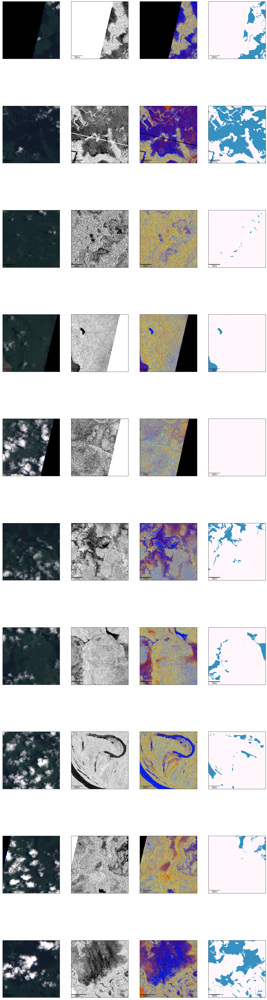

In [13]:
region = 'Bolivia'
num_chips = 10
s2_s1_plots(s1_s2_chips, region, num_chips)


### India

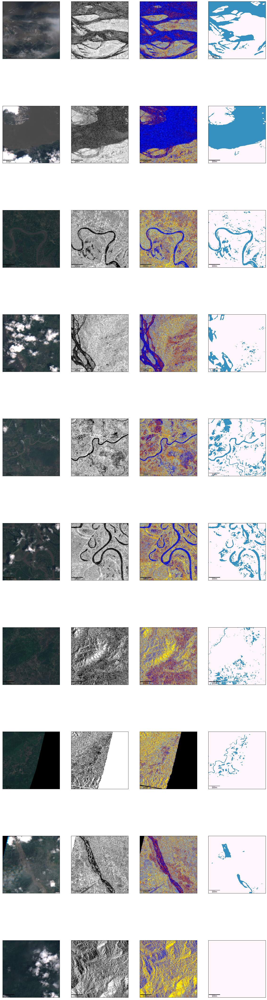

In [14]:
region = 'India'
num_chips = 10
s2_s1_plots(s1_s2_chips, region, num_chips)


### Paraguay

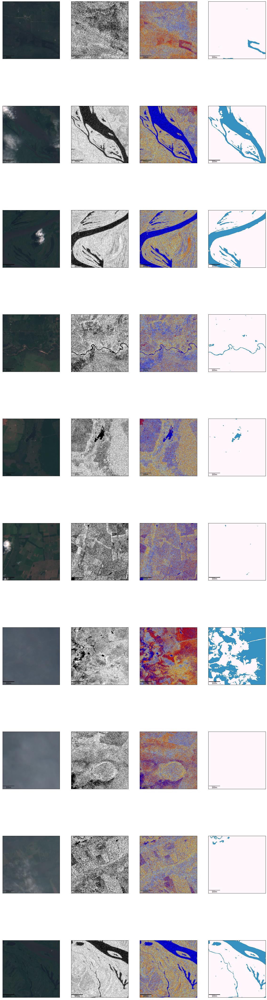

In [15]:
region = 'Paraguay'
num_chips = 10
s2_s1_plots(s1_s2_chips, region, num_chips)


### Sri-Lanka

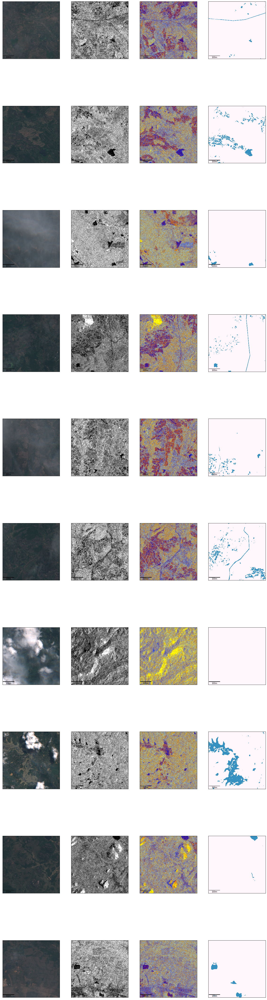

In [16]:
region = 'Sri-Lanka'
num_chips = 10
s2_s1_plots(s1_s2_chips, region, num_chips)


Pick an image from each region and create a combined chart

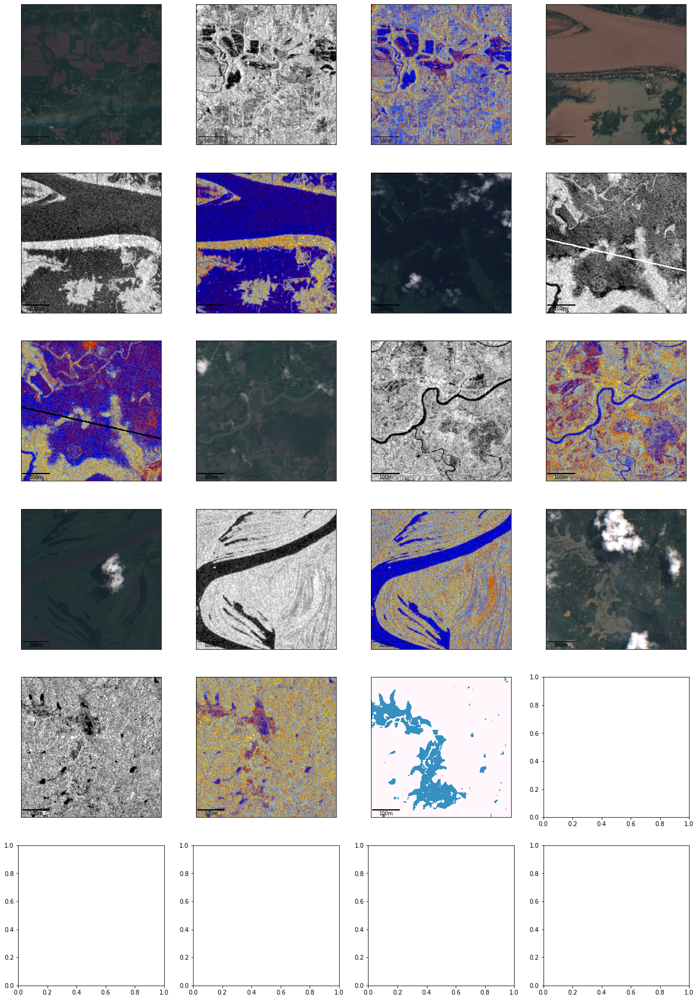

In [17]:
ind_by_region = {'USA': 3, 'Mekong': 9, 'Bolivia': 1, 'India': 4, 'Paraguay': 2, 'Sri-Lanka': 7}

fig, ax = plt.subplots(6, 4, figsize=(20, 30))
ax = ax.ravel()

# plot the chosen indices
for idx, (region, ind) in enumerate(ind_by_region.items()):

    # plot the Sentinel-2 chip
    rgb_resc_int(ax[num_col * idx], s1_s2_chips[region][ind][0], pct_low=2, pct_high=95)
    #ax[num_col * idx].imshow(hand_s1_s2_chips['USA'][idx][0])

    # plot the Sentinel-1 VV band
    s1_clip_int(ax[num_col * idx + 1], s1_s2_chips[region][ind][1])

    # display the Sentinel-1 VH band
    s1_clip_int(ax[num_col * idx + 2], s1_s2_chips[region][ind][2])

    # display label
    display_label(ax[num_col * idx + 3], s1_s2_chips[region][ind][3], cmap=lbl_cmap)